# Deep Learning Workshop - Assignment 3 - Pascal VOC 2007

### *Roy Levy - 313577611*
---


### In this assignment we will try to build a fully-convolutional neural network in order to adress the technique of Super-Resolution<br>Our main goal is trying to improve details of images with bad resolution, the process in order to achieve this goal will be presented in the following article.

### We will use the Pascal VOC 2007 dataset. This dataset is comprise of 5011 with 288x288 images, which we will consider as high resolution.<br> Our goal is to transform these images to low resolution and try to predict with these pictures the high resolution ones.

In [1]:
from tensorflow import keras
import numpy as np
import pandas as pd
import os
import tensorflow as tf
import matplotlib.pyplot as plt
from matplotlib.pyplot import imread
from tensorflow.keras.preprocessing.image import load_img
import cv2
import gc
import random
import math
from keras import backend as K

from tensorflow.keras.layers import Conv2D,UpSampling2D,Input,LeakyReLU,Activation, add, Concatenate,Lambda
from tensorflow.keras import Model
from tensorflow.keras.applications.vgg16 import VGG16

Using TensorFlow backend.


# Loading the images
---
### We will start by loading the images, notice that we will use small amount of images first in order to check if our process works.<br>Once we will get a better understanding of the data we will load all of it and try to use it in our models.

In [2]:
def load_imgs(how_many):
    """
        returns images in range of 'how_many'
    """
    path = '../input/pascal-voc-2007/voctrainval_06-nov-2007/VOCdevkit/VOC2007/JPEGImages/'
    imgs_path = os.listdir(path)
    imgs = []
    
    for i,img in enumerate(imgs_path):
        if(i >= how_many):
            return imgs
        imgs.append(load_img(path+img))
    return imgs        

In [3]:
def to_np_array(images):
    new_images = []
    for image in images:
        new_images.append(np.array(image))
    return (np.array(new_images)/255.0)

In [4]:
def get_resized_images(images,size):
    """
        returns 3 np.arrays of the resized images
        the sizes are 72x72, 144x144, 288x288
    """
    imgs = []
    
    for img in images:
        img = img.resize((size,size))
        imgs.append(img)
        
    return to_np_array(imgs)

In [5]:
# loading only the first 100 pictures
imgs = load_imgs(100)

# getting the images in 72X72, 144X144, 288X288 pixels
imgs_72 = get_resized_images(imgs,72)
imgs_144 = get_resized_images(imgs,144)
imgs_288 = get_resized_images(imgs,288)

# printing the images shape
imgs_72.shape,imgs_144.shape,imgs_288.shape

((100, 72, 72, 3), (100, 144, 144, 3), (100, 288, 288, 3))

In [6]:
def plot_imgs(rows,cols,imgs,titles):
    """
        plots images side by side
    """
    fix,ax = plt.subplots(rows,cols,figsize=(20,12))
    for i in range(len(imgs)):
        if len(imgs)//cols > 1:
            ax[i//cols,i%cols].set_title(titles[i])
            ax[i//cols,i%cols].imshow(imgs[i])
        else:
            ax[i].set_title(titles[i])
            ax[i].imshow(imgs[i])

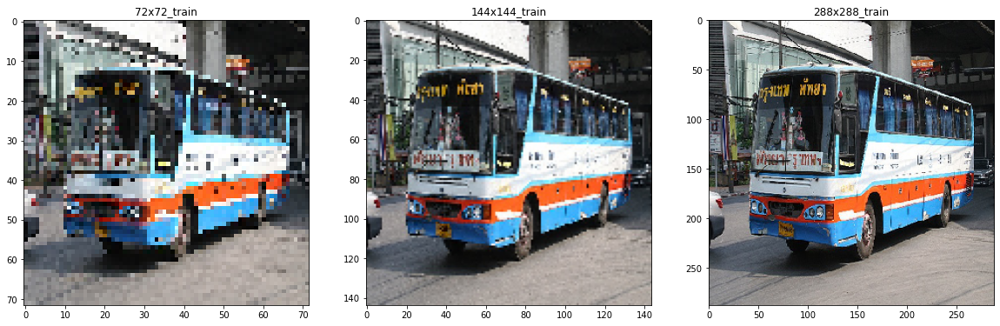

In [7]:
titles_3 = ["72x72_train","144x144_train","288x288_train"]
curr_img = 5
plot_imgs(1,3,[imgs_72[curr_img],imgs_144[curr_img],imgs_288[curr_img]],titles_3)

### In order to save memory we will define the image generators below

In [8]:
def get_gen_one(lower,upper,size,epochs=1):
    for e in range(epochs):
        path = '../input/pascal-voc-2007/voctrainval_06-nov-2007/VOCdevkit/VOC2007/JPEGImages/'
        imgs_path = os.listdir(path)
    
        for i,img in enumerate(imgs_path):
            if(i in range(lower,upper)):
                curr_img = load_img(path+img)
                curr_img = curr_img.resize((size,size))
                curr_img = np.array(curr_img)/255.0
                yield np.expand_dims(curr_img,axis=0)

In [9]:
def get_gen_two(lower,upper,size0,size1,epochs=1):
    for e in range(epochs):
        path = '../input/pascal-voc-2007/voctrainval_06-nov-2007/VOCdevkit/VOC2007/JPEGImages/'
        imgs_path = os.listdir(path)
    
        for i,img in enumerate(imgs_path):
            if(i in range(lower,upper)):
                curr_img0 = load_img(path+img)
                curr_img0 = curr_img0.resize((size0,size0))
                curr_img0 = np.array(curr_img0)/255.0
            
                curr_img1 = load_img(path+img)
                curr_img1 = curr_img1.resize((size1,size1))
                curr_img1 = np.array(curr_img1)/255.0
            
                yield np.expand_dims(curr_img0,axis=0), np.expand_dims(curr_img1,axis=0)

In [10]:
def get_gen_three(lower,upper,size0,size1,size2,epochs=1):
    for e in range(epochs):
        path = '../input/pascal-voc-2007/voctrainval_06-nov-2007/VOCdevkit/VOC2007/JPEGImages/'
        imgs_path = os.listdir(path)
    
        for i,img in enumerate(imgs_path):
            if(i in range(lower,upper)):
                curr_img = load_img(path+img)
                curr_img0 = curr_img.resize((size0,size0))
                curr_img0 = np.array(curr_img0)/255.0
            
                curr_img1 = curr_img.resize((size1,size1))
                curr_img1 = np.array(curr_img1)/255.0
            
                curr_img2 = curr_img.resize((size2,size2))
                curr_img2 = np.array(curr_img2)/255.0
            
                yield np.expand_dims(curr_img0,axis=0), [np.expand_dims(curr_img1,axis=0), np.expand_dims(curr_img2,axis=0)]

## Building Our First Model - ConvNN on 72x72 images
---
### We will start by building a simple convolutional model in the following architechture.<br>We will predict on the 144x144 images.

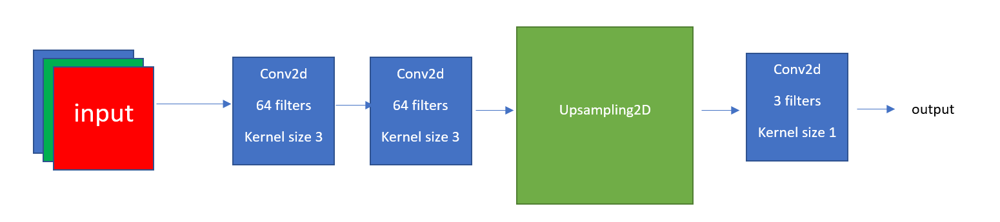

In [11]:
def get_simple_sr_model():
    inp = Input(shape=(None,None,3))
    x = Conv2D(64,3,activation=LeakyReLU(0.2),padding='same')(inp)
    x = Conv2D(64,3,activation=LeakyReLU(0.2),padding='same')(x)    
    x = UpSampling2D()(x)
    x = Conv2D(3,1,activation='sigmoid',padding='same',name="output_144")(x)
    
    return Model(inp,x)

### We will use the following callback:<br> on each end of epoch our model will predict on all the images given to the callback.<br>The predictions will be later be save as GIF's.

In [12]:
import tensorflow
from PIL import Image

class Gif_Callback(tensorflow.keras.callbacks.Callback):
    
    def __init__(self,imgs,names,folder,two=True):
        super().__init__()
        self.imgs = imgs
        self.preds = []
        for i in range(len(self.imgs)):
            self.preds.append([])
        self.names = names
        self.folder = folder
        os.makedirs('./'+self.folder)
        self.two = two
        
    def on_epoch_end(self, epoch, logs=None):
        for i in range(len(self.imgs)):
            pred = self.model.predict(self.imgs[i])
            self.preds[i].append(pred)
            
    def save_gif(self,p,path,size):
        mult = 30
        imgs = []
        for pi in p:
            pi = np.array(pi)
            pi = np.squeeze(pi)
            img = Image.fromarray(np.uint8(pi*255))
            img = img.resize((size,size))
        
            for i in range(mult):
                imgs.append(img)
                
        imgs[0].save(path,
               save_all=True, append_images=imgs[1:], optimize=False, duration=40, loop=0)
        
        
    def on_train_end(self,logs=None):

        for i in range(len(self.preds)):
            p = self.preds[i]
            path_0 = './'+self.folder+'/'+str(self.names[i])+'_144.gif'
            path_1 = './'+self.folder+'/'+str(self.names[i])+'_288.gif'
            if(self.two):
                self.save_gif(p[0],path_0,144)
                self.save_gif(p[1],path_1,288)
            else:
                self.save_gif(p,path_0,144)

In [13]:
names = np.arange(10)
imgs_gif = imgs_72[:10]
imgs_gif = list(map(lambda img : np.expand_dims(img,axis=0),imgs_gif))

In [14]:
first_sr_model = get_simple_sr_model()
first_sr_model.compile(loss='mse',optimizer='adam')

imgs_72_144_gen_train = get_gen_two(0,80,72,144,20)
imgs_72_144_gen_val = get_gen_two(80,100,72,144,20)

history_first = first_sr_model.fit_generator(imgs_72_144_gen_train,
                              steps_per_epoch=80,
                              validation_data=imgs_72_144_gen_val,
                              validation_steps = 20,
                              epochs=20,
                              callbacks=[Gif_Callback(imgs_gif,names,"model1",two=False)])

Epoch 1/20
80/80 [==============================] - 3s 34ms/step - loss: 0.0420 - val_loss: 0.0126
Epoch 2/20
80/80 [==============================] - 3s 31ms/step - loss: 0.0132 - val_loss: 0.0107
Epoch 3/20
80/80 [==============================] - 2s 28ms/step - loss: 0.0116 - val_loss: 0.0104
Epoch 4/20
80/80 [==============================] - 2s 29ms/step - loss: 0.0113 - val_loss: 0.0102
Epoch 5/20
80/80 [==============================] - 2s 28ms/step - loss: 0.0112 - val_loss: 0.0101
Epoch 6/20
80/80 [==============================] - 2s 29ms/step - loss: 0.0110 - val_loss: 0.0100
Epoch 7/20
80/80 [==============================] - 3s 32ms/step - loss: 0.0109 - val_loss: 0.0099
Epoch 8/20
80/80 [==============================] - 2s 28ms/step - loss: 0.0108 - val_loss: 0.0098
Epoch 9/20
80/80 [==============================] - 2s 28ms/step - loss: 0.0107 - val_loss: 0.0098
Epoch 10/20
80/80 [==============================] - 2s 28ms/step - loss: 0.0107 - val_loss: 0.0098
Epoch 11/

In [15]:
def plot_psnr(history,titles):
    plt.figure(figsize=(10,5))
    for title in titles:
        plt.plot(history.history[title])
    
    plt.title('Model loss PSNR')
    plt.ylabel('PSNR Loss')
    plt.xlabel('Epoch')
    plt.legend(titles, loc='lower right')
    plt.show()

In [16]:
def plot_losses(history,psnr=True):
    """
        plot losses based on a given model history
    """
    all_titles = [*history.history.keys()]
    psnr_titles = list(filter(lambda t: "PSNR" in t,all_titles))
    titles = list(filter(lambda t: "PSNR" not in t,all_titles))
    
    plt.figure(figsize=(10,5))
    for title in titles:
        plt.plot(history.history[title])
    
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(titles,loc="upper right")
    plt.show()
    if(psnr):
        plot_psnr(history,psnr_titles)

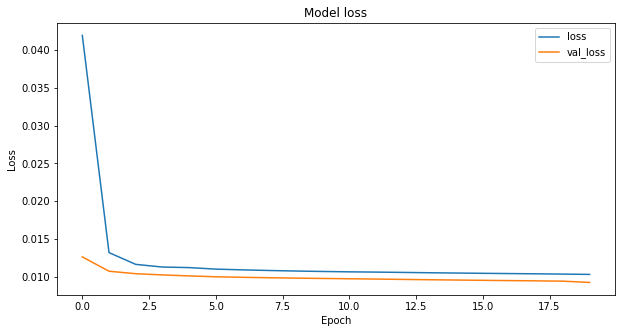

In [17]:
plot_losses(history_first,psnr=False)

### as we can see the loss based on 'mse' is around 0.01. we will try to improve this.<br>still we need to rememeber that this is just a small chunk of our data.<br><br> Now let's look on our predictions so far...

In [18]:
def plot_predict_imgs(rows,cols,preds,stop,offset,titles):
    for i in range(stop):
        preds_lst = [preds[j][i] for j in range(len(preds))]
        imgs_lst = [imgs_72[i+offset],imgs_144[i+offset],imgs_288[i+offset]]
        plot_imgs(rows,cols,imgs_lst+preds_lst,titles)

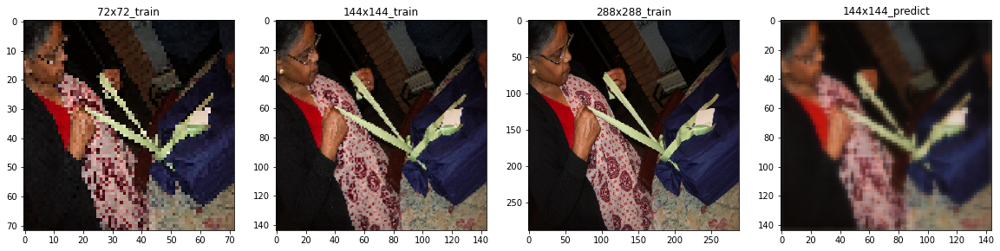

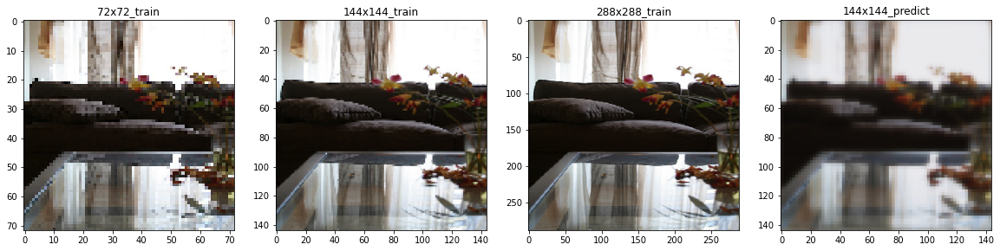

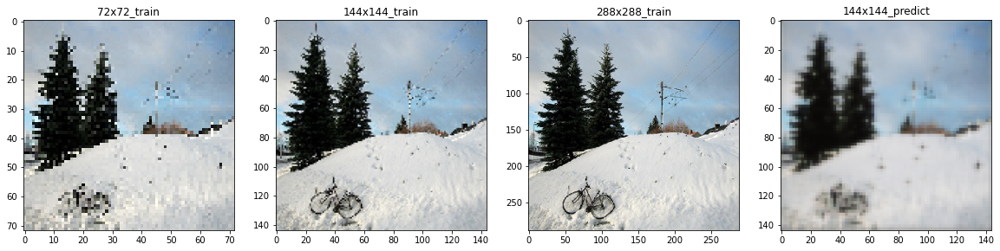

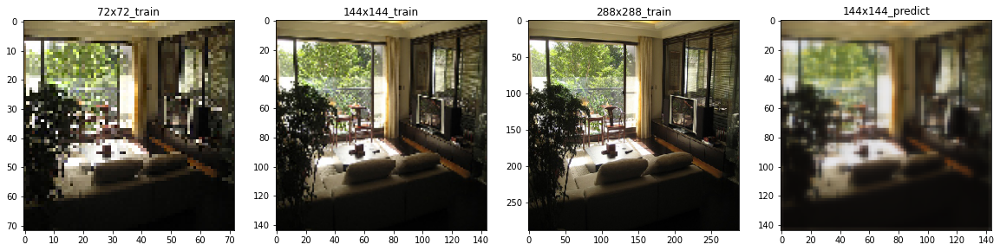

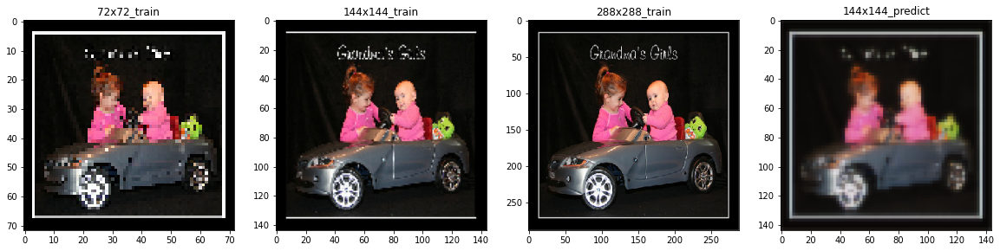

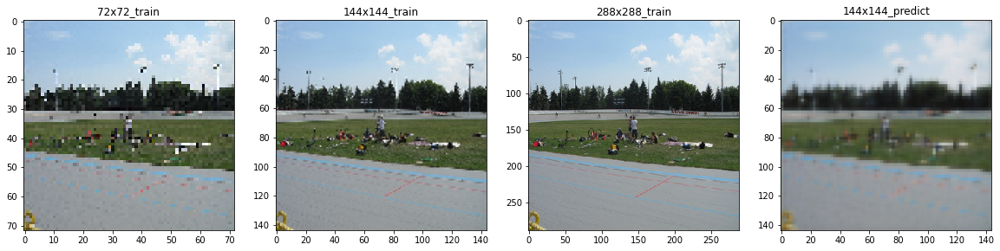

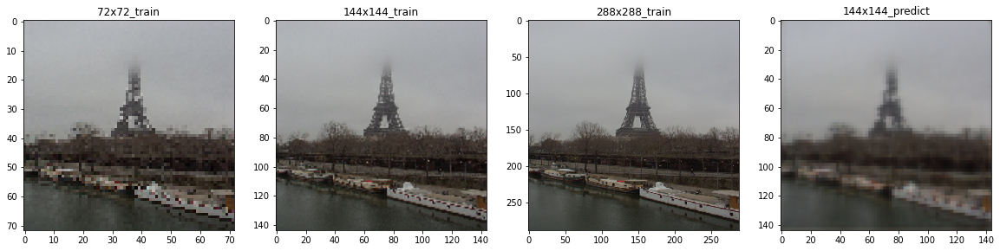

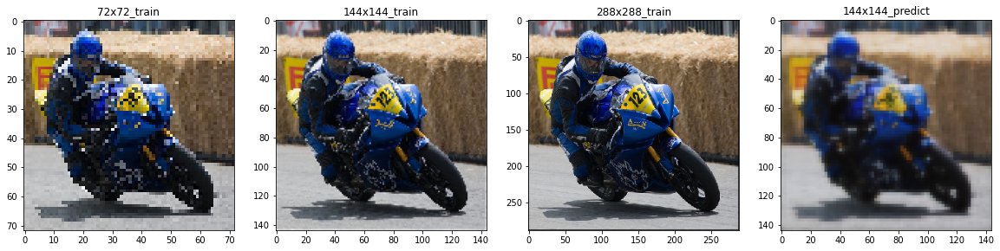

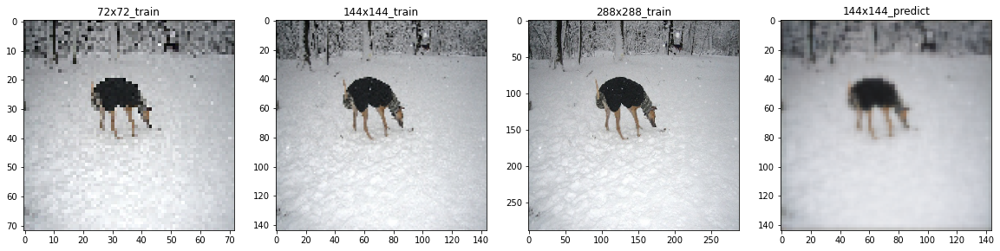

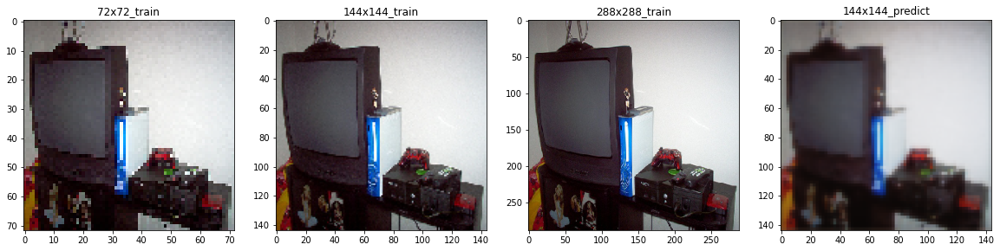

In [19]:
# predicting on the last 20 images - validation_data
titles_4 = ["72x72_train","144x144_train","288x288_train","144x144_predict"]
preds_first_sr = first_sr_model.predict(imgs_72[80:])
plot_predict_imgs(1,4,[preds_first_sr],10,80,titles_4)

### We can see that our images looks pixelized. The improvment is noticeable but is minor.

## Building Our Second Model
---
### We will try to get a better understanding where our model is more effecient.<br> In order to do so we will add another output layer of the 288x288 images and see the results.

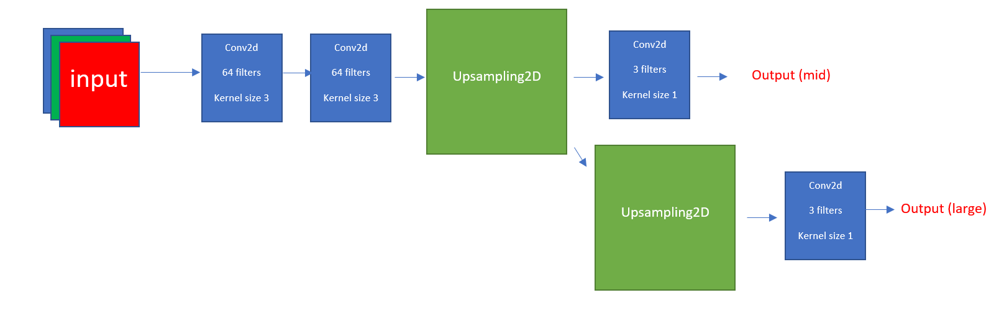

### This model will be later used when we will train on the whole data.<br> We will continue to build modifications based on this model.

In [20]:
def get_second_sr_model():
    inp = Input(shape=(None,None,3))
    x = Conv2D(64,3,activation='relu',padding='same')(inp)
    x = Conv2D(64,3,activation='relu',padding='same')(x)    
    x = UpSampling2D()(x)
    y = UpSampling2D()(x)
    y = Conv2D(3,1,activation='sigmoid',padding='same',name="output_288")(y)   
    x = Conv2D(3,1,activation='sigmoid',padding='same',name="output_144")(x)
    
    return Model(inputs=inp,outputs=[x,y])

In [21]:
second_sr_model = get_second_sr_model()
second_sr_model.compile(loss='mse',optimizer='adam',loss_weights=[0.2,0.8])

imgs_72_144_288_gen_train = get_gen_three(0,80,72,144,288,20)
imgs_72_144_288_gen_val = get_gen_three(80,100,72,144,288,20)

history_second = second_sr_model.fit_generator(imgs_72_144_288_gen_train,
                              steps_per_epoch=80,
                              validation_data=imgs_72_144_288_gen_val,
                              validation_steps = 20,
                              epochs=20,
                              callbacks=[Gif_Callback(imgs_gif,names,"model2")])

Epoch 1/20
80/80 [==============================] - 2s 22ms/step - loss: 0.0466 - output_144_loss: 0.0624 - output_288_loss: 0.0427 - val_loss: 0.0148 - val_output_144_loss: 0.0227 - val_output_288_loss: 0.0128
Epoch 2/20
80/80 [==============================] - 2s 20ms/step - loss: 0.0140 - output_144_loss: 0.0162 - output_288_loss: 0.0134 - val_loss: 0.0108 - val_output_144_loss: 0.0121 - val_output_288_loss: 0.0105
Epoch 3/20
80/80 [==============================] - 2s 20ms/step - loss: 0.0117 - output_144_loss: 0.0125 - output_288_loss: 0.0115 - val_loss: 0.0106 - val_output_144_loss: 0.0113 - val_output_288_loss: 0.0104
Epoch 4/20
80/80 [==============================] - 2s 20ms/step - loss: 0.0115 - output_144_loss: 0.0119 - output_288_loss: 0.0114 - val_loss: 0.0103 - val_output_144_loss: 0.0107 - val_output_288_loss: 0.0102
Epoch 5/20
80/80 [==============================] - 2s 25ms/step - loss: 0.0116 - output_144_loss: 0.0118 - output_288_loss: 0.0116 - val_loss: 0.0101 - val

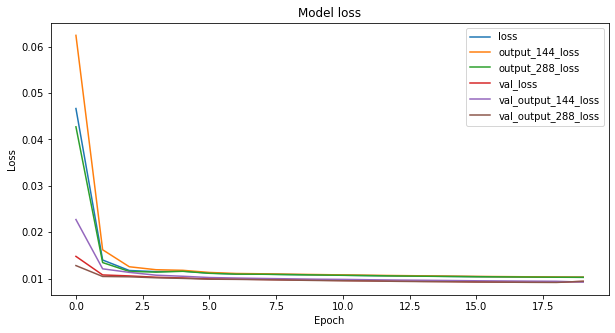

In [22]:
plot_losses(history_second,psnr=False)

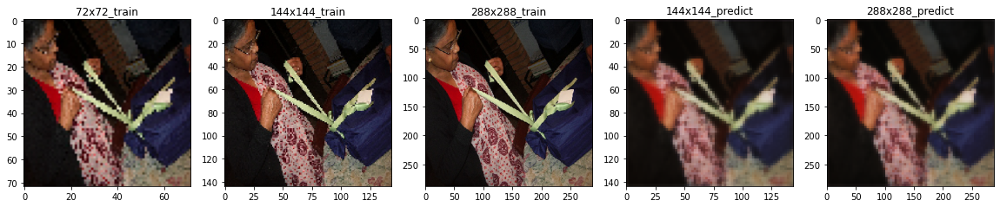

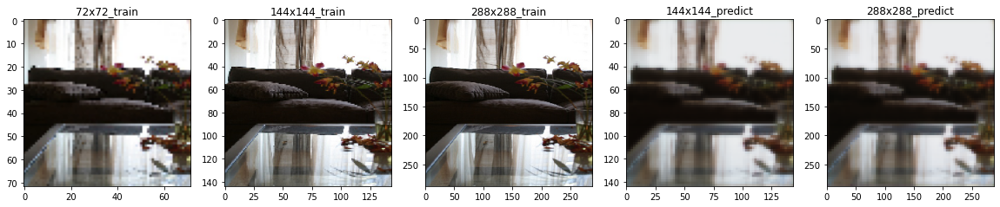

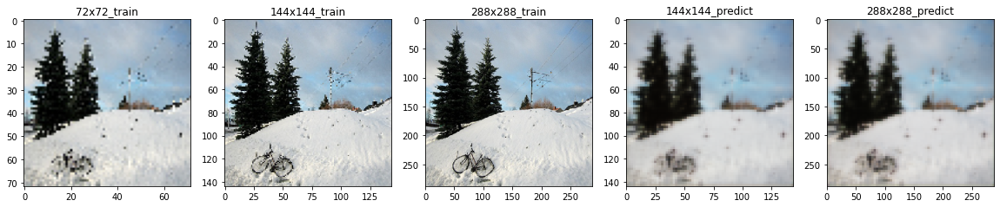

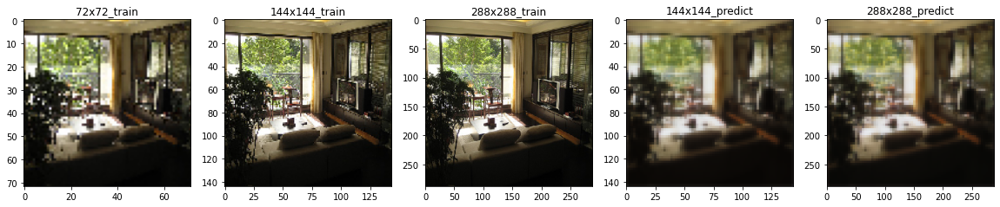

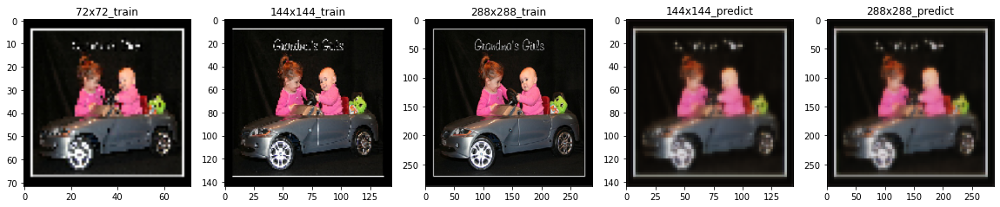

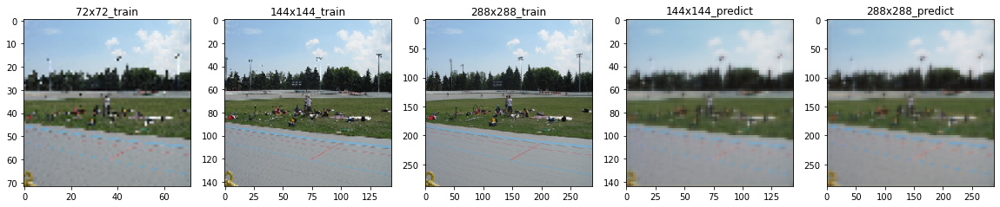

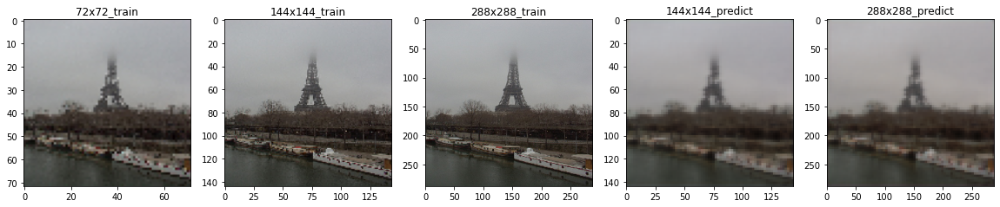

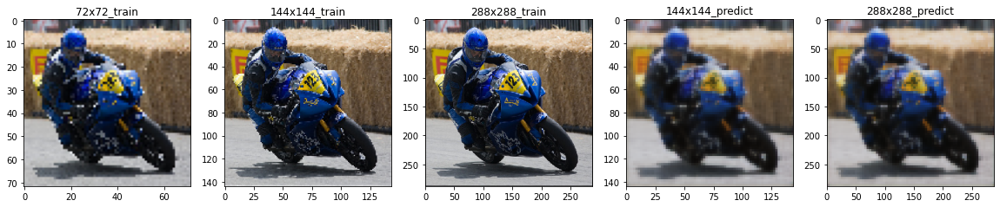

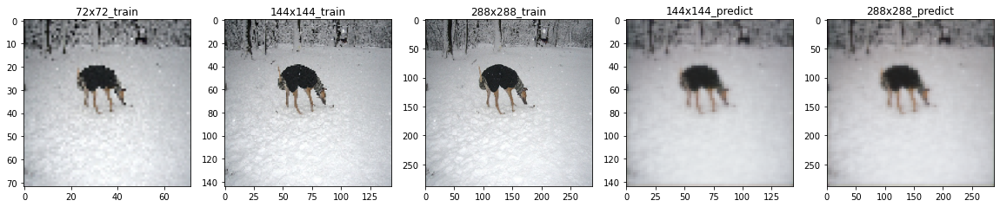

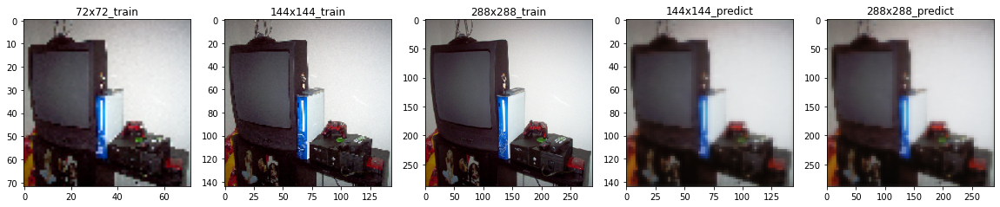

In [23]:
titles_5 = ["72x72_train","144x144_train","288x288_train","144x144_predict","288x288_predict"]
preds_second_sr = second_sr_model.predict(imgs_72[80:])
plot_predict_imgs(1,5,preds_second_sr,10,80,titles_5)

In [24]:
del preds_second_sr
gc.collect()

113211

### We can see that the transition between the 72x72 train images to the other images are quite the same, in the case of 288x288 the colors are a bit off.

## Building Our Third Model
---
### After we got a better understanding on how to use our second model it's time to test it on the whole data.<br>First we will load the images and resize them as before, then test it on the second model.

### First we will define the following PSNR(peak signal to noise ratio) metric, which is relevant to our super-resolution task.

In [25]:
def PSNR(y_true, y_pred):
    max_pixel = 1.0
    return (10.0 * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - y_true), axis=-1)))) / 2.303

In [26]:
imgs_72_144_gen_train = get_gen_three(1000,5012,72,144,288,4)
imgs_72_144_288_gen_val = get_gen_three(0,1000,72,144,288,4)

In [27]:
third_sr_model = get_second_sr_model()
third_sr_model.compile(loss='mse',optimizer='adam',loss_weights=[0.2,0.8],metrics=[PSNR])

# validating on the first 1000 images, training on the rest
history_third = third_sr_model.fit_generator(imgs_72_144_gen_train,
                                             steps_per_epoch=4011,
                                             validation_data=imgs_72_144_288_gen_val,
                                             validation_steps = 1000,
                                             epochs=4,
                                             callbacks=[Gif_Callback(imgs_gif,names,"model3")])

Epoch 1/4
4011/4011 [==============================] - 73s 18ms/step - loss: 0.0115 - output_144_loss: 0.0117 - output_288_loss: 0.0114 - output_144_PSNR: 27.6179 - output_288_PSNR: 27.7189 - val_loss: 0.0105 - val_output_144_loss: 0.0104 - val_output_288_loss: 0.0105 - val_output_144_PSNR: 28.9290 - val_output_288_PSNR: 28.8740
Epoch 2/4
4011/4011 [==============================] - 67s 17ms/step - loss: 0.0103 - output_144_loss: 0.0102 - output_288_loss: 0.0103 - output_144_PSNR: 28.9453 - output_288_PSNR: 28.9000 - val_loss: 0.0103 - val_output_144_loss: 0.0103 - val_output_288_loss: 0.0103 - val_output_144_PSNR: 29.6954 - val_output_288_PSNR: 29.6578
Epoch 3/4
4011/4011 [==============================] - 67s 17ms/step - loss: 0.0101 - output_144_loss: 0.0101 - output_288_loss: 0.0101 - output_144_PSNR: 29.3587 - output_288_PSNR: 29.3065 - val_loss: 0.0103 - val_output_144_loss: 0.0102 - val_output_288_loss: 0.0103 - val_output_144_PSNR: 30.1729 - val_output_288_PSNR: 30.2395
Epoch 4

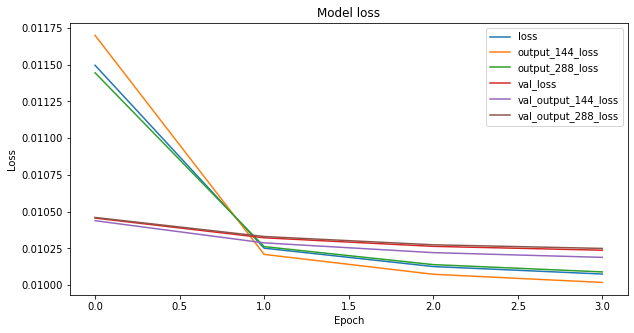

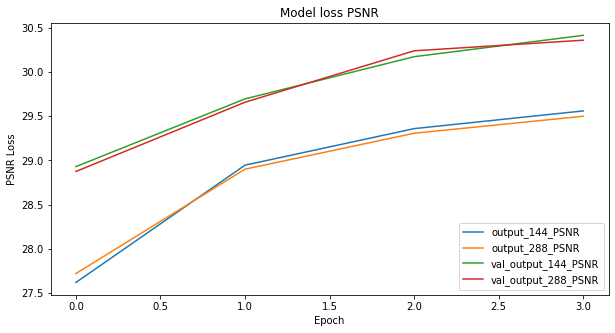

In [28]:
plot_losses(history_third)

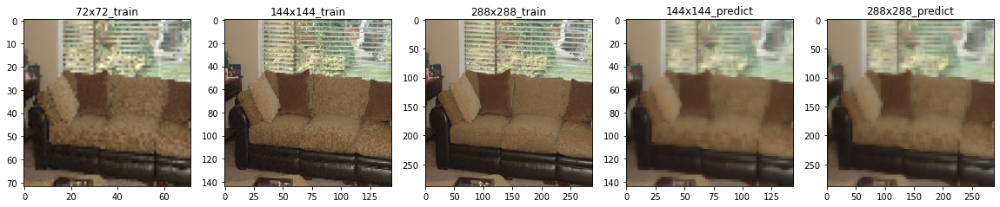

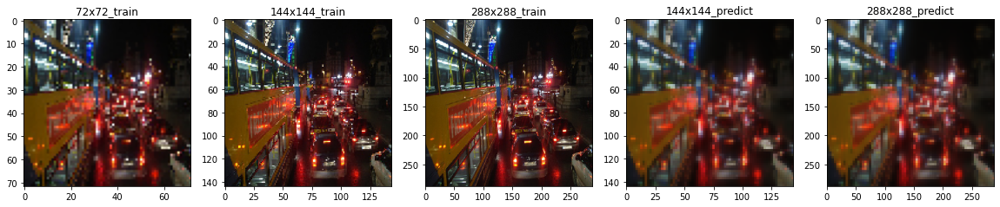

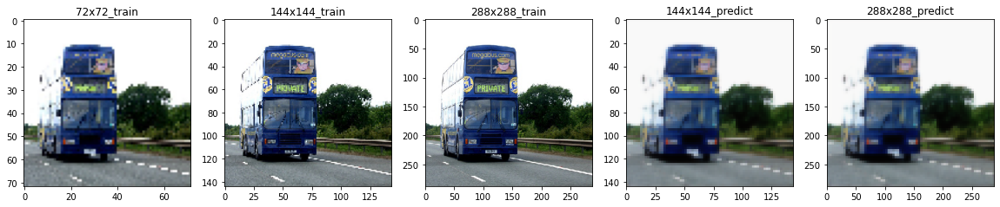

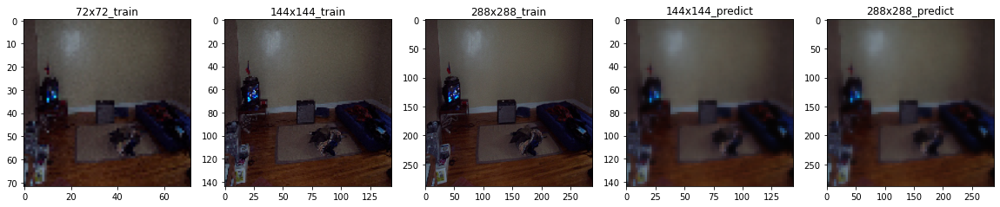

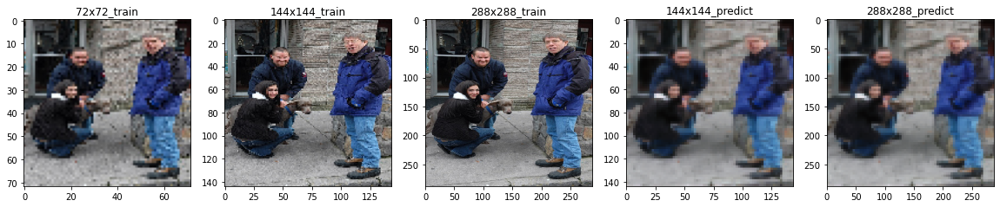

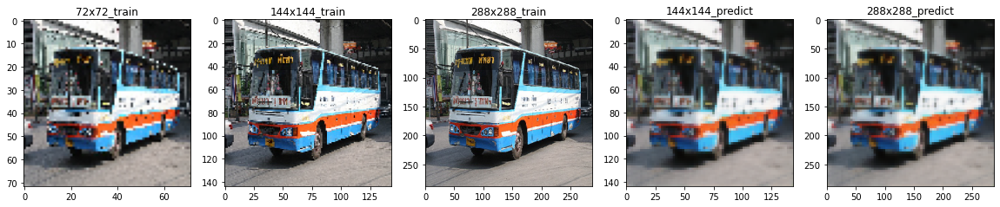

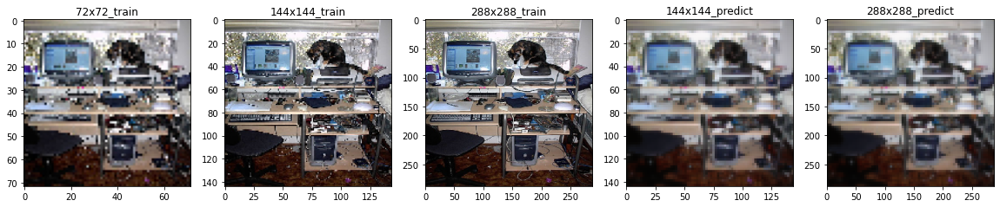

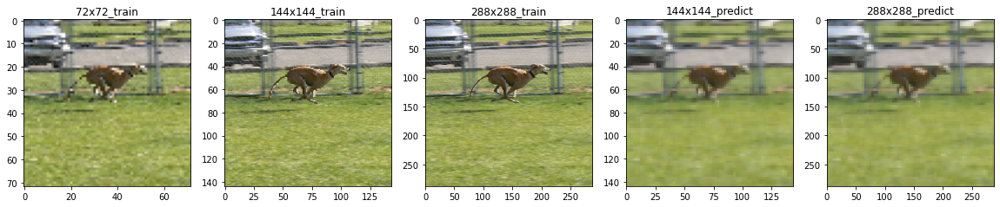

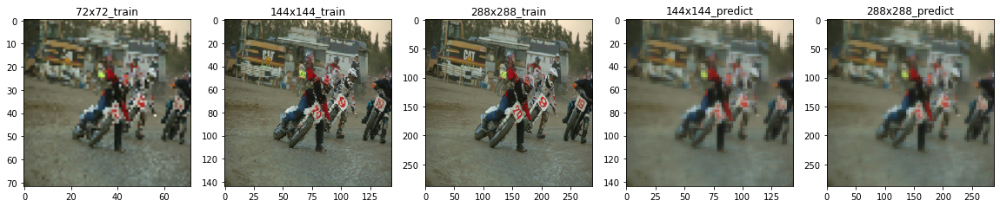

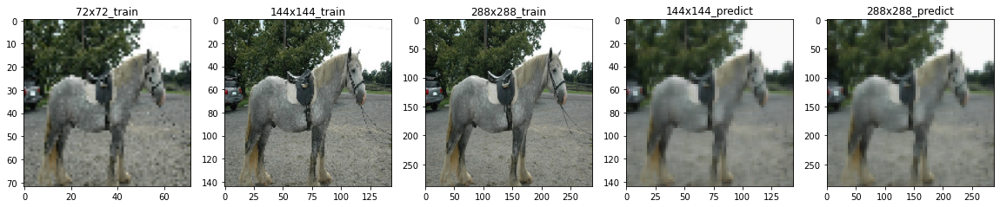

In [29]:
imgs_72_144_288_gen_val = get_gen_three(0,1000,72,144,288)
preds_third_sr = third_sr_model.predict_generator(imgs_72_144_288_gen_val,1000)
plot_predict_imgs(1,5,preds_third_sr,10,0,titles_5)

### We can see a littile improvement from our previous models, the predictions are still quite pixelized.<br><br>Let's try another method

In [30]:
del preds_third_sr
gc.collect()

113231

## Building Our Fourth Model
---
### We will try to improve our model by adding a residual block.<br>We will construct our model based on the following architecture.
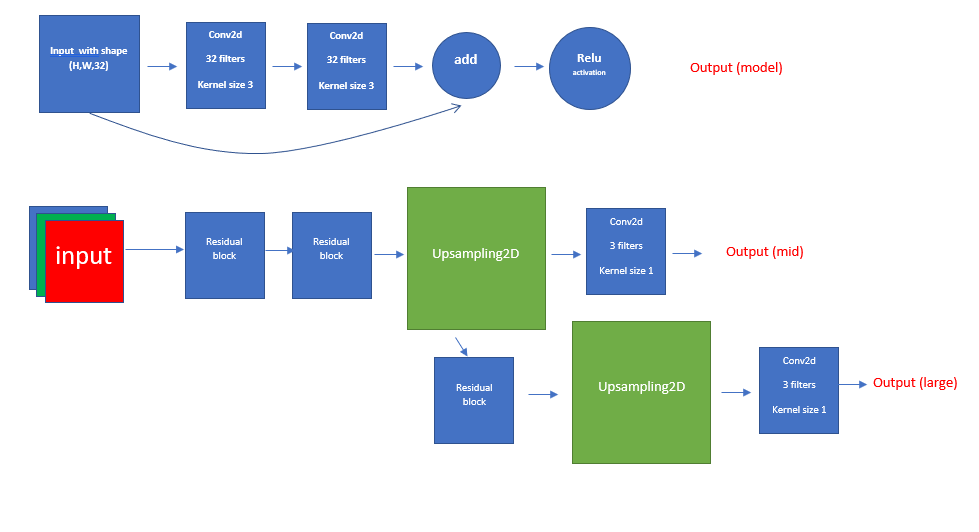


In [31]:
def residual_block(h,w,num_cnl):
    inp = Input(shape=(h,w,num_cnl))
    x = Conv2D(num_cnl,3,padding='same',activation=LeakyReLU(0.2))(inp)
    x = Conv2D(num_cnl,3,padding='same',activation=LeakyReLU(0.2))(x)
    x = add([inp,x])
    return Model(inp,Activation(LeakyReLU(0.2))(x))

In [32]:
def residual_sr_model(h=None,w=None):
    inp = Input(shape=(h,w,3))
    x = Conv2D(32,3,padding='same',activation=LeakyReLU(0.2))(inp)
    x = residual_block(h,w,32)(x)
    x = residual_block(h,w,32)(x)
    x = UpSampling2D(size=(2,2))(x)
    y = residual_block(h,w,32)(x)
    y = UpSampling2D(size=(2,2))(y)
    y = Conv2D(3,1,activation='sigmoid',padding='same',name="output_288")(y)  
    x = Conv2D(3,1,activation='sigmoid',padding='same',name="output_144")(x)
    return Model(inputs=inp,outputs=[x,y])

In [33]:
imgs_72_144_gen_train = get_gen_three(1000,5012,72,144,288,4)
imgs_72_144_288_gen_val = get_gen_three(0,1000,72,144,288,4)

In [34]:
fourth_sr_model = residual_sr_model()
fourth_sr_model.compile(loss='mse',optimizer='adam',metrics=[PSNR])

# validating on the first 1000 images, training on the rest
history_fourth = fourth_sr_model.fit_generator(imgs_72_144_gen_train,
                                             steps_per_epoch=4011,
                                             validation_data=imgs_72_144_288_gen_val,
                                             validation_steps = 1000,
                                             epochs=4,
                                             callbacks=[Gif_Callback(imgs_gif,names,"model4")])

Epoch 1/4
4011/4011 [==============================] - 69s 17ms/step - loss: 0.0227 - output_144_loss: 0.0115 - output_288_loss: 0.0111 - output_144_PSNR: 27.5381 - output_288_PSNR: 27.4038 - val_loss: 0.0228 - val_output_144_loss: 0.0113 - val_output_288_loss: 0.0114 - val_output_144_PSNR: 27.2803 - val_output_288_PSNR: 26.7225
Epoch 2/4
4011/4011 [==============================] - 69s 17ms/step - loss: 0.0200 - output_144_loss: 0.0102 - output_288_loss: 0.0098 - output_144_PSNR: 28.7726 - output_288_PSNR: 28.6234 - val_loss: 0.0202 - val_output_144_loss: 0.0103 - val_output_288_loss: 0.0098 - val_output_144_PSNR: 29.3209 - val_output_288_PSNR: 29.3479
Epoch 3/4
4011/4011 [==============================] - 68s 17ms/step - loss: 0.0196 - output_144_loss: 0.0100 - output_288_loss: 0.0095 - output_144_PSNR: 29.2136 - output_288_PSNR: 29.2079 - val_loss: 0.0199 - val_output_144_loss: 0.0102 - val_output_288_loss: 0.0097 - val_output_144_PSNR: 29.4487 - val_output_288_PSNR: 29.3865
Epoch 4

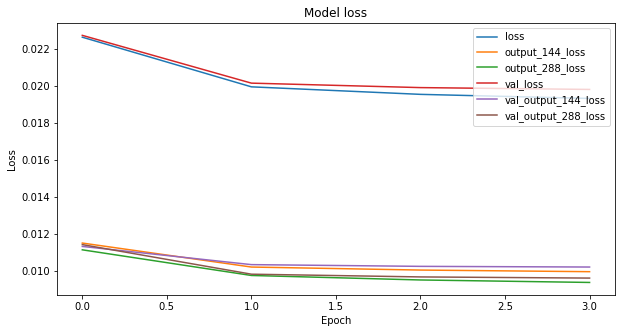

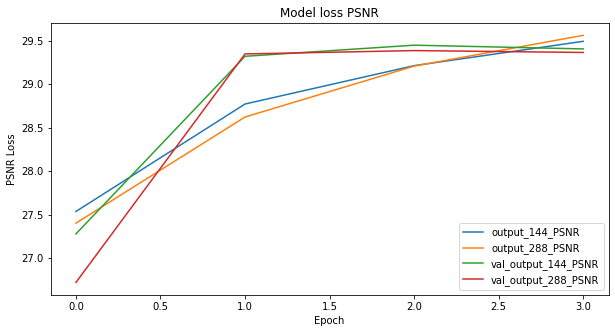

In [35]:
plot_losses(history_fourth)

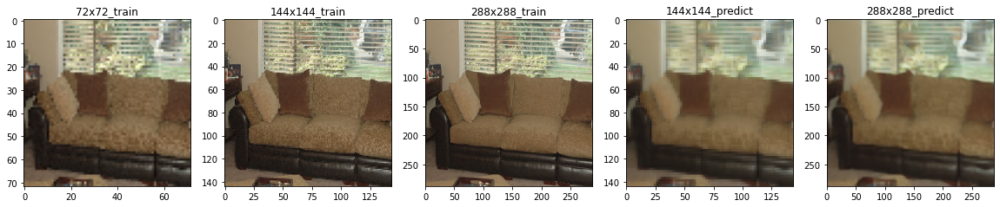

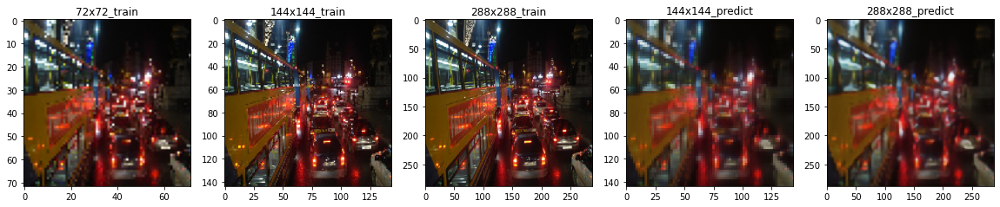

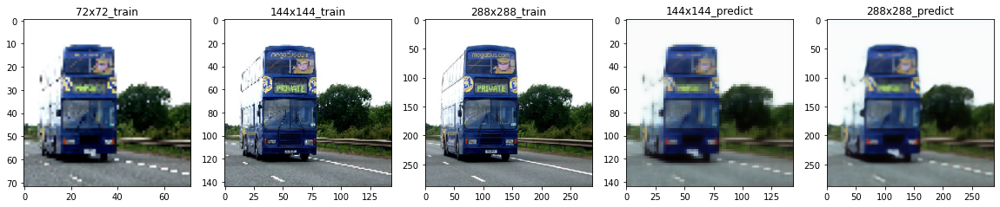

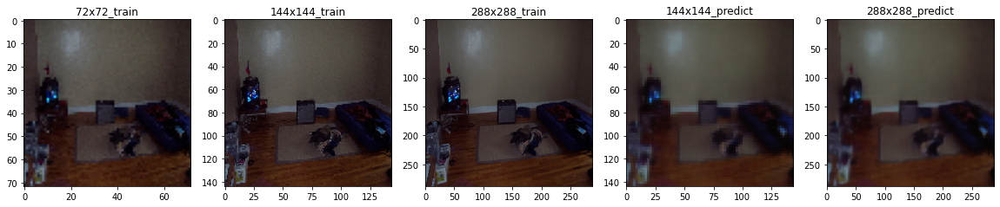

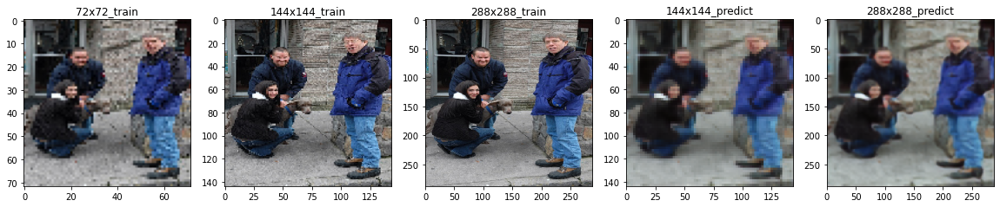

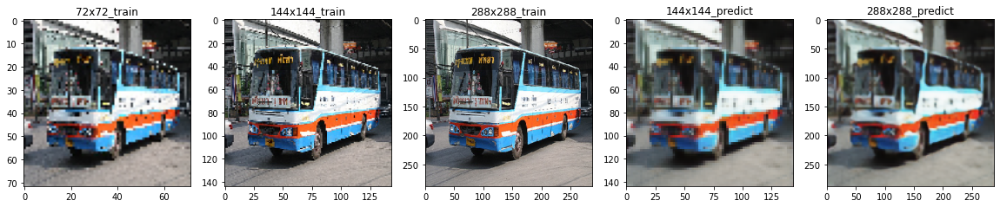

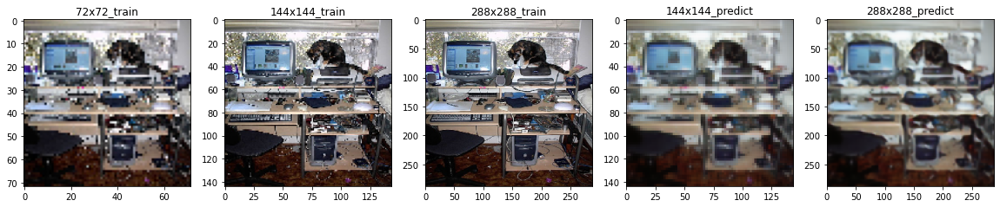

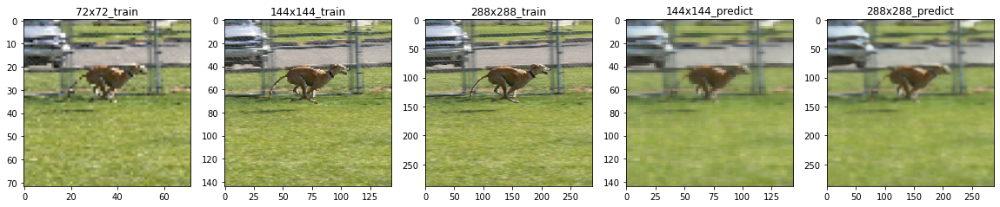

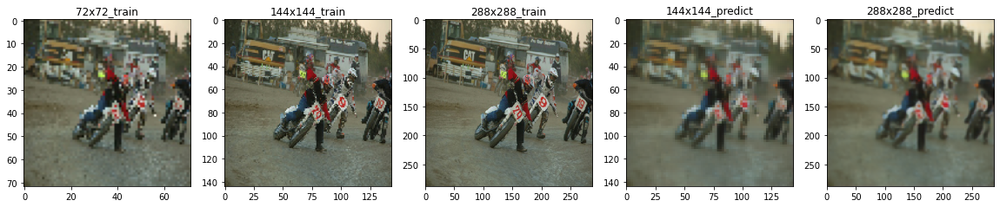

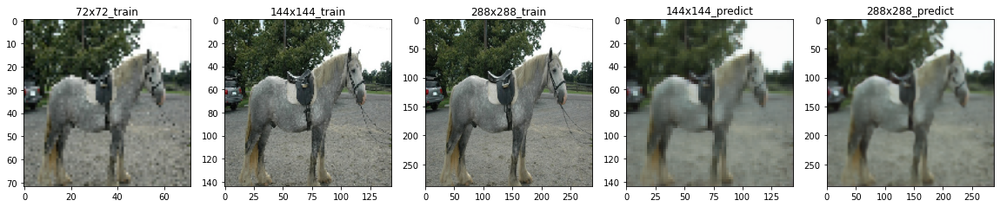

In [36]:
imgs_72_144_288_gen_val = get_gen_three(0,1000,72,144,288)
preds_fourth_sr = fourth_sr_model.predict_generator(imgs_72_144_288_gen_val,1000)
plot_predict_imgs(1,5,preds_fourth_sr,10,0,titles_5)

### We can see a major improvment from the previous model. Although the predictions are relativly blurry, they are much less pixelized especially in the 288x288 predictions. 

In [37]:
del preds_fourth_sr
gc.collect()

113246

## Building Our Fifth Model
---
### We will try another approach. Instead on the residual block we will add a dialated block, this notion is because we wan't learn also big areas of the input.<br>We will construct our model based on the following architecture.
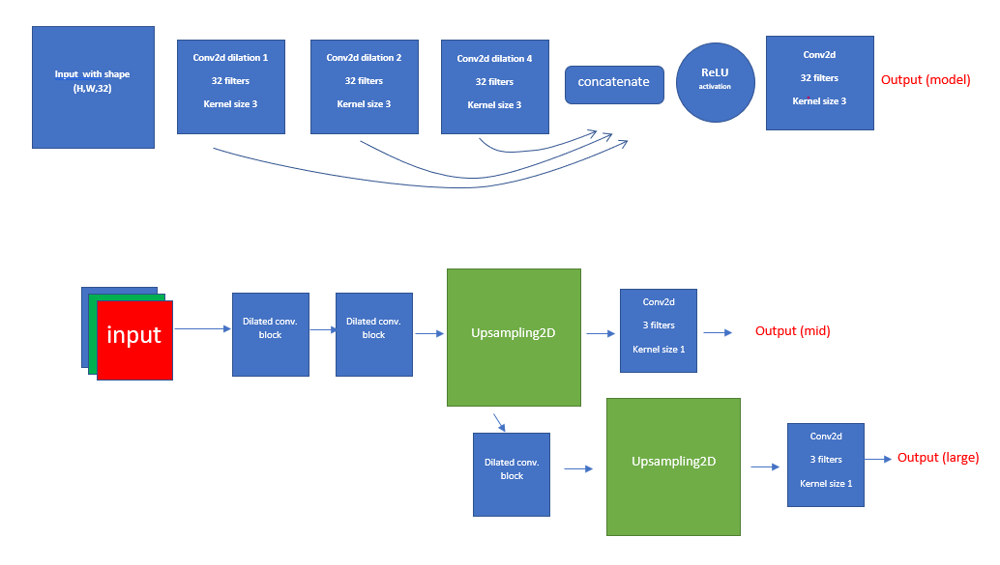

In [38]:
def dilated_block(h,w,num_cnl):
    inp = Input(shape=(h,w,num_cnl), name='input')
    d1 = Conv2D(32, 3, padding='same', dilation_rate=(1,1), activation= LeakyReLU(0.2))(inp)
    d2 = Conv2D(32, 3, padding='same', dilation_rate=(2,2), activation=LeakyReLU(0.2))(inp)
    d3 = Conv2D(32, 3, padding='same', dilation_rate=(4,4), activation=LeakyReLU(0.2))(inp)
    x = Concatenate()([d1,d2,d3])
    x = Activation('relu')(x)
    x = Conv2D(32, kernel_size=(3,3), padding='same', activation='relu')(x)
    return Model(inp,x)

In [39]:
def dilated_sr_model(h=None,w=None):
    inp = Input(shape=(h,w,3))
    x = Conv2D(32,3,padding='same',activation=LeakyReLU(0.2))(inp)
    x = dilated_block(h,w,32)(x)
    x = dilated_block(h,w,32)(x)
    x = UpSampling2D(size=(2,2))(x)
    y = dilated_block(h,w,32)(x)
    y = UpSampling2D(size=(2,2))(y)
    y = Conv2D(3,1,activation='sigmoid',padding='same',name="output_288")(y)  
    x = Conv2D(3,1,activation='sigmoid',padding='same',name="output_144")(x)
    return Model(inputs=inp,outputs=[x,y])

In [40]:
imgs_72_144_gen_train = get_gen_three(1000,5012,72,144,288,4)
imgs_72_144_288_gen_val = get_gen_three(0,1000,72,144,288,4)

In [41]:
fifth_sr_model = dilated_sr_model()
fifth_sr_model.compile(loss='mse',optimizer='adam',metrics=[PSNR])

# validating on the first 1000 images, training on the rest
history_fifth = fifth_sr_model.fit_generator(imgs_72_144_gen_train,
                                             steps_per_epoch=4011,
                                             validation_data=imgs_72_144_288_gen_val,
                                             validation_steps = 1000,
                                             epochs=4,
                                             callbacks=[Gif_Callback(imgs_gif,names,"model5")])

Epoch 1/4
4011/4011 [==============================] - 75s 19ms/step - loss: 0.0252 - output_144_loss: 0.0125 - output_288_loss: 0.0127 - output_144_PSNR: 26.2357 - output_288_PSNR: 25.8190 - val_loss: 0.0219 - val_output_144_loss: 0.0110 - val_output_288_loss: 0.0109 - val_output_144_PSNR: 27.2345 - val_output_288_PSNR: 26.5853
Epoch 2/4
4011/4011 [==============================] - 72s 18ms/step - loss: 0.0209 - output_144_loss: 0.0106 - output_288_loss: 0.0103 - output_144_PSNR: 27.7799 - output_288_PSNR: 27.5045 - val_loss: 0.0224 - val_output_144_loss: 0.0113 - val_output_288_loss: 0.0111 - val_output_144_PSNR: 27.1970 - val_output_288_PSNR: 26.5654
Epoch 3/4
4011/4011 [==============================] - 73s 18ms/step - loss: 0.0203 - output_144_loss: 0.0103 - output_288_loss: 0.0099 - output_144_PSNR: 28.2497 - output_288_PSNR: 28.0280 - val_loss: 0.0213 - val_output_144_loss: 0.0108 - val_output_288_loss: 0.0104 - val_output_144_PSNR: 27.7811 - val_output_288_PSNR: 27.7998
Epoch 4

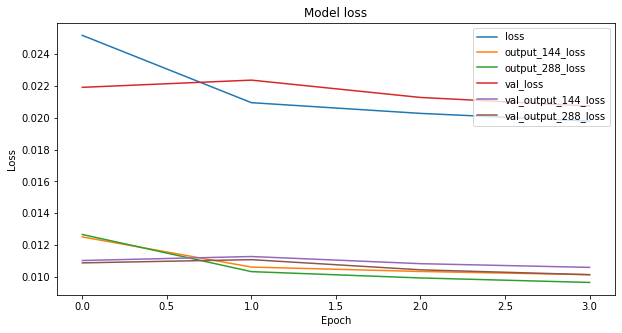

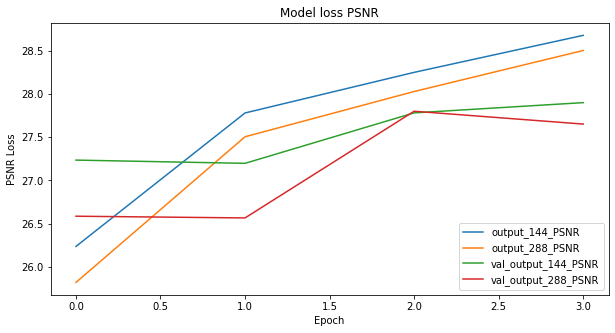

In [42]:
plot_losses(history_fifth)

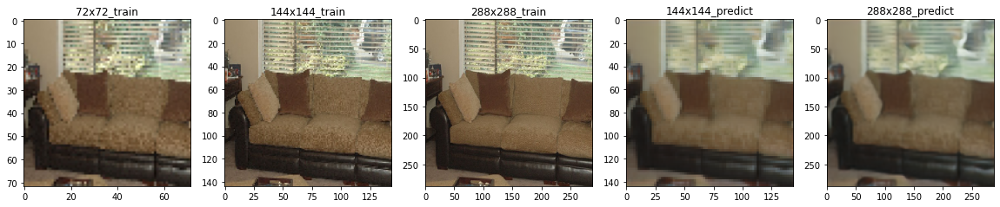

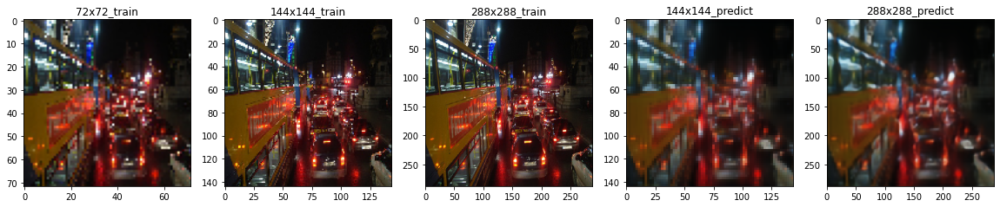

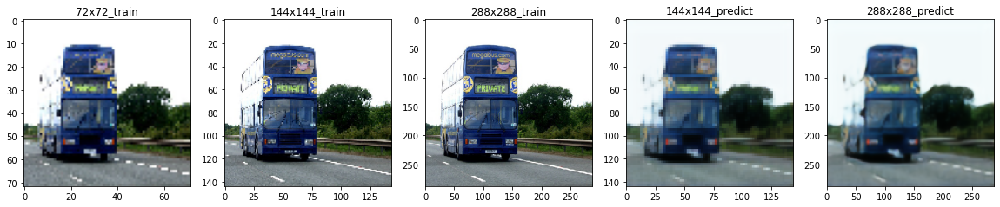

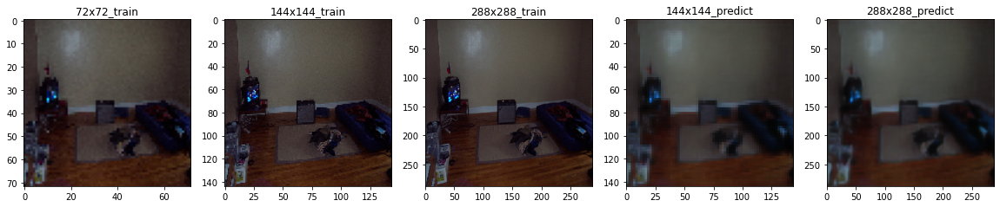

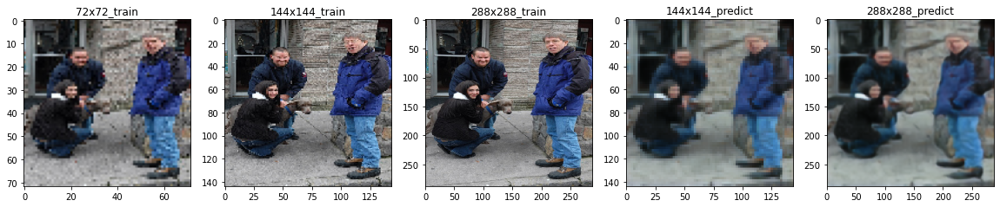

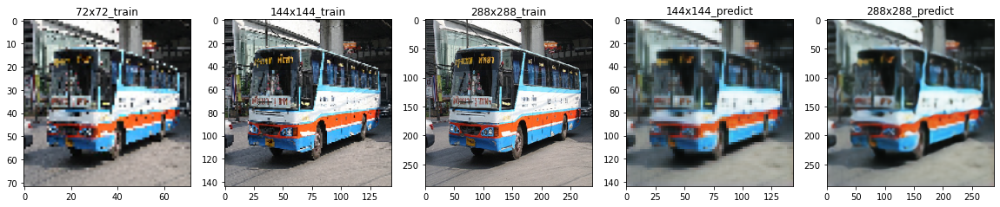

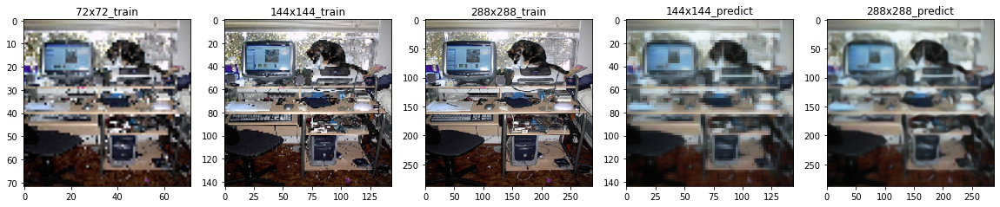

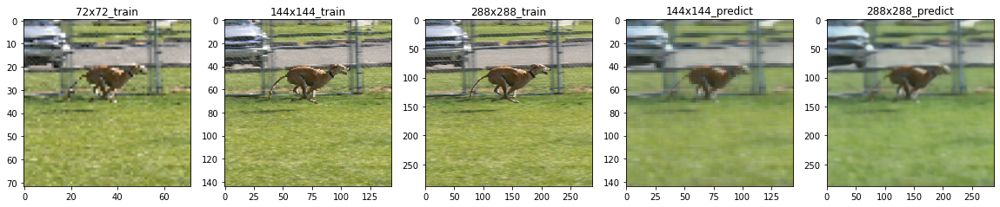

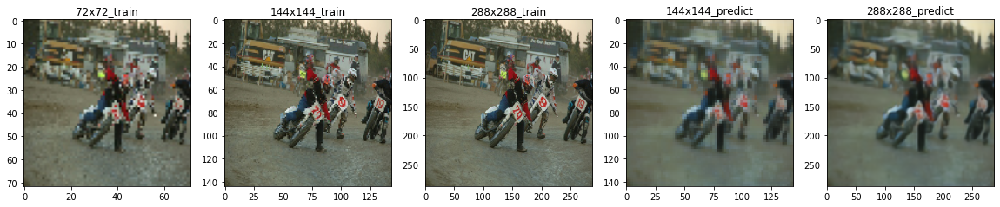

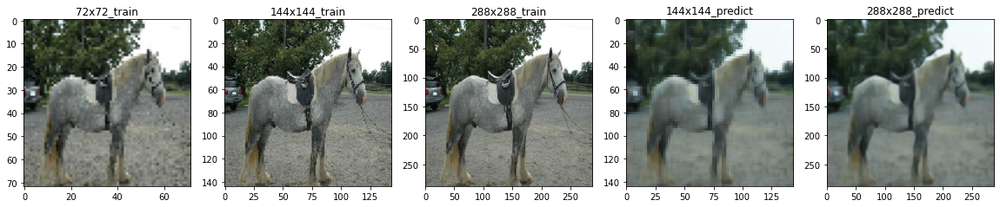

In [43]:
imgs_72_144_288_gen_val = get_gen_three(0,1000,72,144,288)
preds_fifth_sr = fifth_sr_model.predict_generator(imgs_72_144_288_gen_val,1000)
plot_predict_imgs(1,5,preds_fifth_sr,10,0,titles_5)

In [44]:
del preds_fifth_sr
gc.collect()

113230

## Building Our Sixth Model
---
### Another method that we will try is to use feature extractor, for instance VGG16.<br>The goal is to use a pretrained network with our model in order to learn better the transition from bad to better resolution of the images.<br>We will use the following architecture:
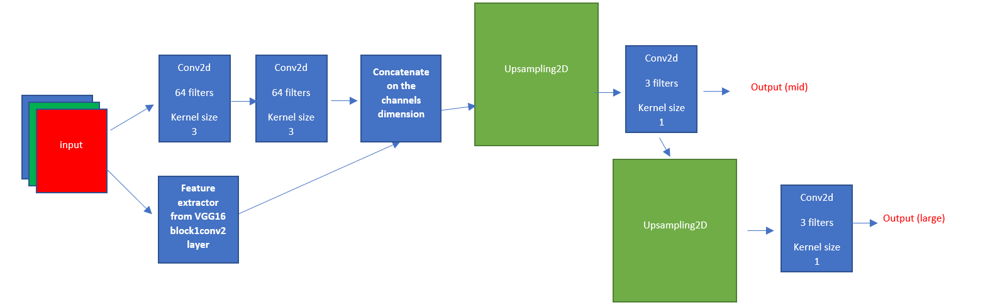

In [45]:
def get_vgg_model(h=None,w=None):
    vgg_model = VGG16(weights='imagenet', include_top=False, input_shape=(None,None,3))
    vgg_layer = Model(inputs=vgg_model.input,outputs=vgg_model.get_layer("block1_conv2").output)
    
    inp = Input(shape=(h,w,3))
    x = Conv2D(64,3,padding='same',activation=LeakyReLU(0.2))(inp)
    vgg = vgg_layer(inp)
    x = Conv2D(64,3,padding='same',activation=LeakyReLU(0.2))(x)
    x = Concatenate()([x,vgg])
    x = UpSampling2D()(x)
    z = Conv2D(3,1,activation='sigmoid',padding='same',name="output_144")(x)
    y = UpSampling2D()(z)
    y = Conv2D(3,1,activation='sigmoid',padding='same',name="output_288")(y)   
    return Model(inputs=inp,outputs=[z,y])  

In [46]:
imgs_72_144_gen_train = get_gen_three(1000,5012,72,144,288,4)
imgs_72_144_288_gen_val = get_gen_three(0,1000,72,144,288,4)

In [47]:
sixth_sr_model = get_vgg_model()
sixth_sr_model.compile(loss='mse',optimizer='adam',metrics=[PSNR])

# validating on the first 1000 images, training on the rest
history_sixth = sixth_sr_model.fit_generator(imgs_72_144_gen_train,
                                             steps_per_epoch=4011,
                                             validation_data=imgs_72_144_288_gen_val,
                                             validation_steps = 1000,
                                             epochs=4,
                                             callbacks=[Gif_Callback(imgs_gif,names,"model6")])

58892288/58889256 [==============================] - 0s 0us/step
Epoch 1/4
4011/4011 [==============================] - 67s 17ms/step - loss: 0.0476 - output_144_loss: 0.0137 - output_288_loss: 0.0339 - output_144_PSNR: 24.5219 - output_288_PSNR: 18.0759 - val_loss: 0.0296 - val_output_144_loss: 0.0114 - val_output_288_loss: 0.0182 - val_output_144_PSNR: 26.5698 - val_output_288_PSNR: 21.0103
Epoch 2/4
4011/4011 [==============================] - 66s 16ms/step - loss: 0.0256 - output_144_loss: 0.0107 - output_288_loss: 0.0150 - output_144_PSNR: 27.6547 - output_288_PSNR: 22.7362 - val_loss: 0.0236 - val_output_144_loss: 0.0107 - val_output_288_loss: 0.0129 - val_output_144_PSNR: 28.0871 - val_output_288_PSNR: 24.2968
Epoch 3/4
4011/4011 [==============================] - 67s 17ms/step - loss: 0.0221 - output_144_loss: 0.0103 - output_288_loss: 0.0118 - output_144_PSNR: 28.4967 - output_288_PSNR: 25.3223 - val_loss: 0.0218 - val_output_144_loss: 0.0104 - val_output_288_loss: 0.0114 - va

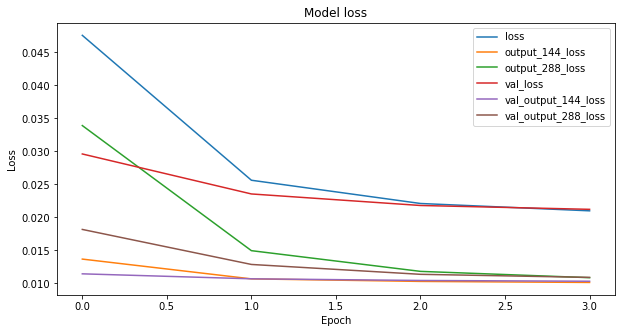

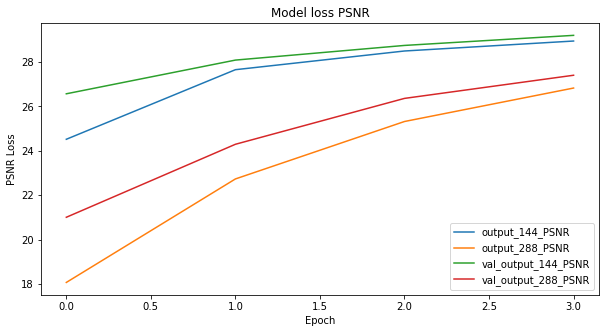

In [48]:
plot_losses(history_sixth)

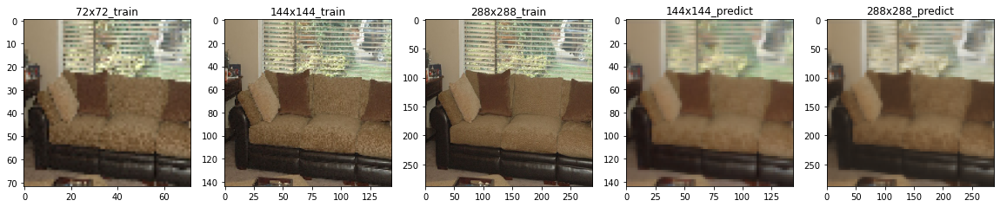

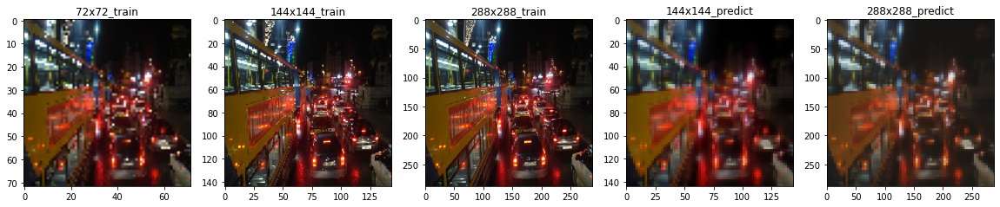

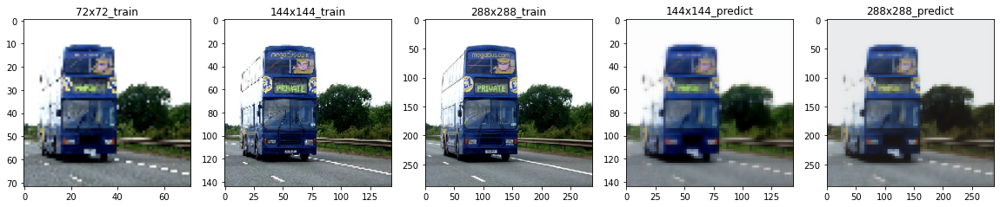

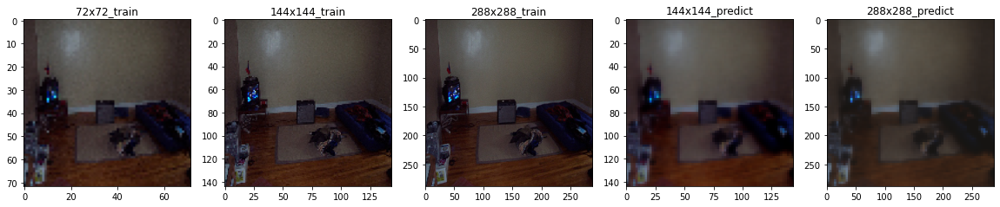

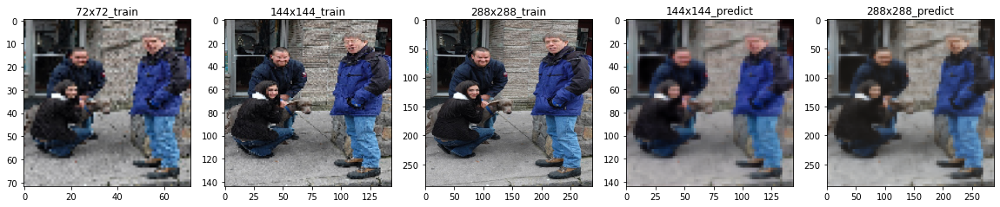

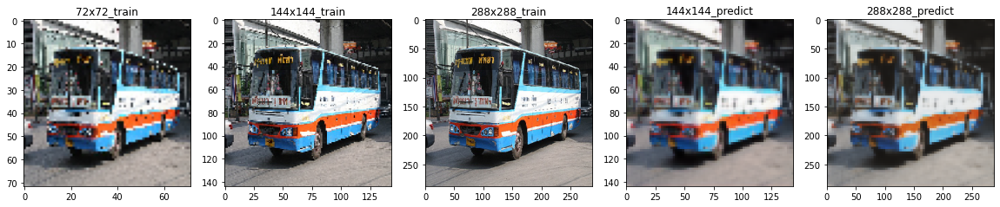

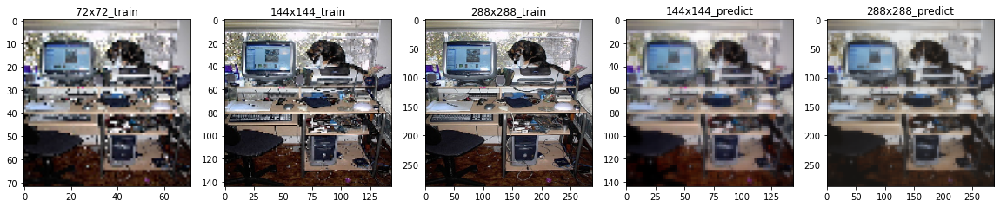

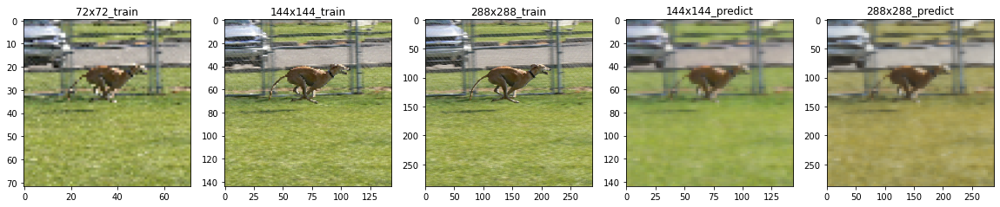

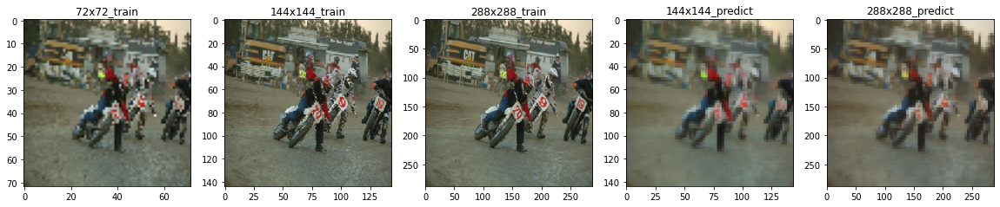

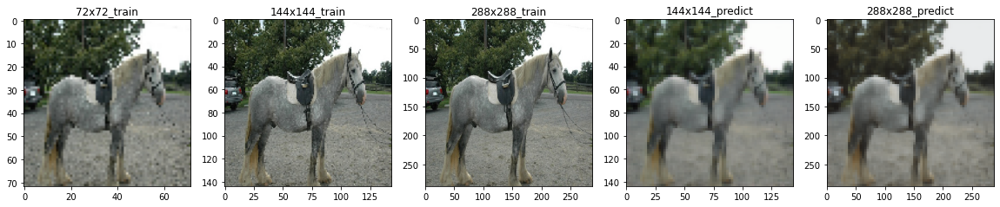

In [49]:
imgs_72_144_288_gen_val = get_gen_three(0,1000,72,144,288)
preds_sixth_sr = sixth_sr_model.predict_generator(imgs_72_144_288_gen_val,1000)
plot_predict_imgs(1,5,preds_sixth_sr,10,0,titles_5)

In [50]:
del preds_sixth_sr
gc.collect()

113235

## Building Our Seventh Model
---
### Our final method before will be to replace the upsampling block with depth_to_space blocks. This will allow us to learn pixels that are relativly close to the actual ones, we are performing something like pixel shuffling.
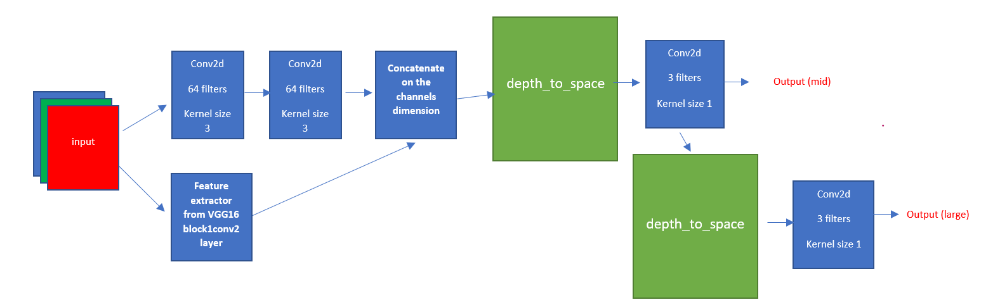

### We will use the following callback in order to present a GIF of this model predictions on each epoch

In [51]:
def get_depth_to_space_model(h=None,w=None):
    vgg_model = VGG16(weights='imagenet', include_top=False, input_shape=(None,None,3))
    vgg_layer = Model(inputs=vgg_model.input,outputs=vgg_model.get_layer("block1_conv2").output)
    
    inp = Input(shape=(h,w,3))
    x = Conv2D(64,3,padding='same',activation=LeakyReLU(0.2))(inp)
    vgg = vgg_layer(inp)
    x = Conv2D(64,3,padding='same',activation=LeakyReLU(0.2))(x)
    x = Concatenate(name="cnt")([x,vgg])
    x = Lambda(lambda x:tf.nn.depth_to_space(x,2),name="lamb")(x)
    x = Conv2D(3,1,activation='sigmoid',padding='same',name="output_144")(x)
    z = Conv2D(64,3,activation='sigmoid',padding='same')(x)
    y = Lambda(lambda x:tf.nn.depth_to_space(x,2),name="lamb2")(z)
    y = Conv2D(3,1,activation='sigmoid',padding='same',name="output_288")(y)
    return Model(inp,outputs=[x,y])
    

In [52]:
imgs_72_144_gen_train = get_gen_three(1000,5012,72,144,288,4)
imgs_72_144_288_gen_val = get_gen_three(0,1000,72,144,288,4)

In [53]:
seventh_sr_model = get_depth_to_space_model()
seventh_sr_model.compile(loss='mse',optimizer='adam',metrics=[PSNR])

# validating on the first 1000 images, training on the rest
history_seventh = seventh_sr_model.fit_generator(imgs_72_144_gen_train,
                                             steps_per_epoch=4011,
                                             validation_data=imgs_72_144_288_gen_val,
                                             validation_steps = 1000,
                                             epochs=4,
                                             callbacks=[Gif_Callback(imgs_gif,names,"model7")])

Epoch 1/4
4011/4011 [==============================] - 67s 17ms/step - loss: 0.0307 - output_144_loss: 0.0121 - output_288_loss: 0.0186 - output_144_PSNR: 26.5694 - output_288_PSNR: 23.3531 - val_loss: 0.0211 - val_output_144_loss: 0.0102 - val_output_288_loss: 0.0109 - val_output_144_PSNR: 28.0511 - val_output_288_PSNR: 26.5597
Epoch 2/4
4011/4011 [==============================] - 66s 17ms/step - loss: 0.0202 - output_144_loss: 0.0098 - output_288_loss: 0.0103 - output_144_PSNR: 28.2517 - output_288_PSNR: 27.0795 - val_loss: 0.0203 - val_output_144_loss: 0.0100 - val_output_288_loss: 0.0103 - val_output_144_PSNR: 28.4634 - val_output_288_PSNR: 27.5057
Epoch 3/4
4011/4011 [==============================] - 66s 16ms/step - loss: 0.0196 - output_144_loss: 0.0097 - output_288_loss: 0.0100 - output_144_PSNR: 28.6372 - output_288_PSNR: 27.4838 - val_loss: 0.0201 - val_output_144_loss: 0.0099 - val_output_288_loss: 0.0102 - val_output_144_PSNR: 28.5604 - val_output_288_PSNR: 27.5906
Epoch 4

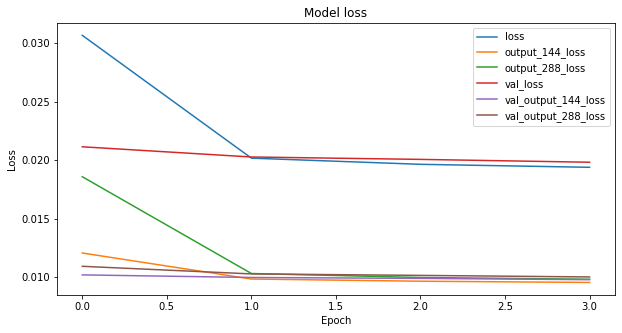

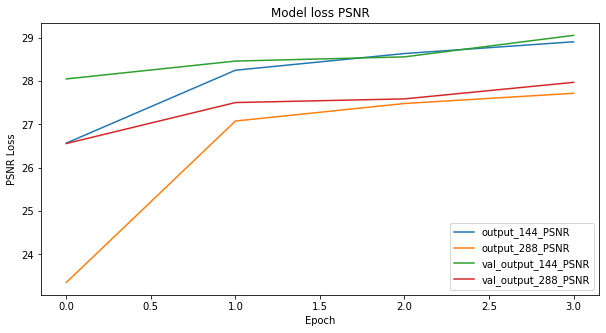

In [54]:
plot_losses(history_seventh)

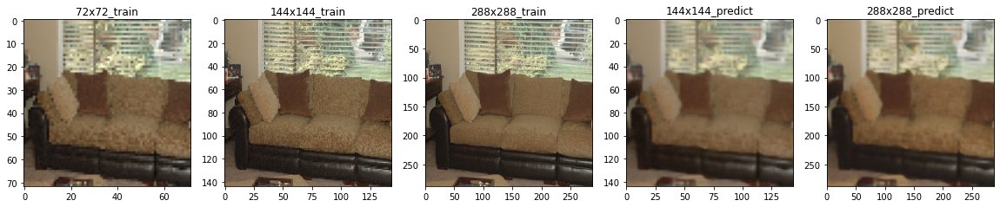

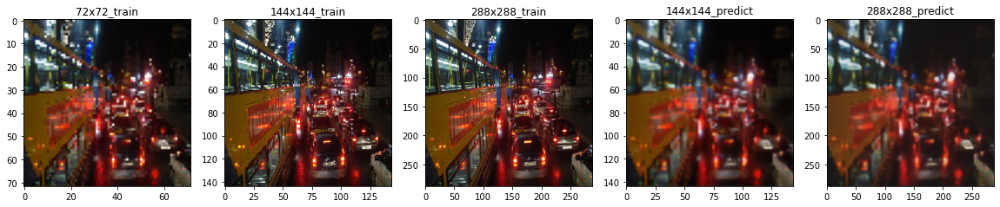

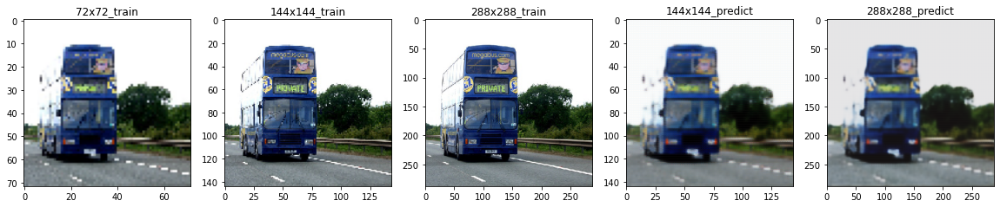

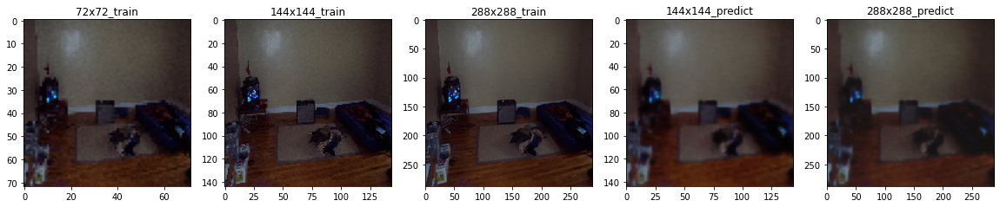

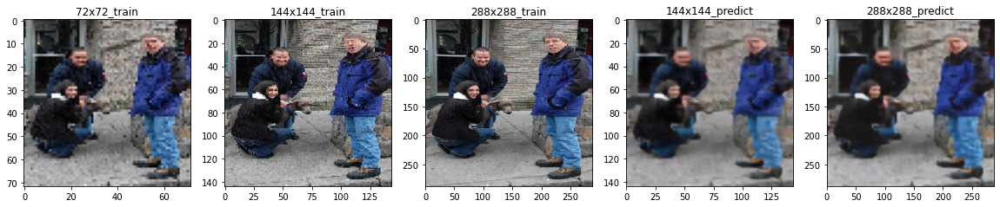

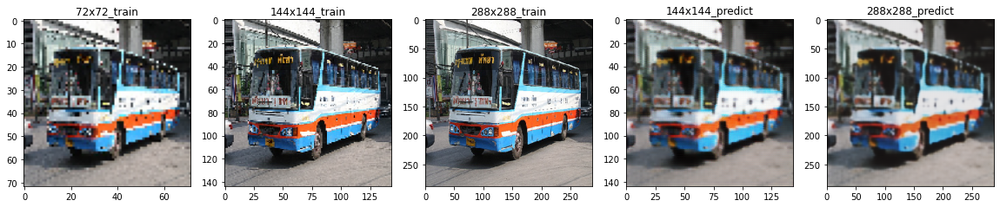

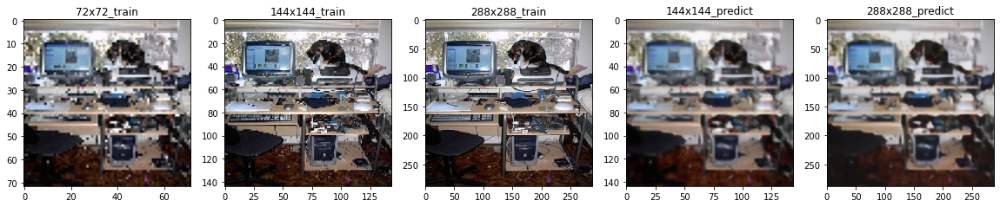

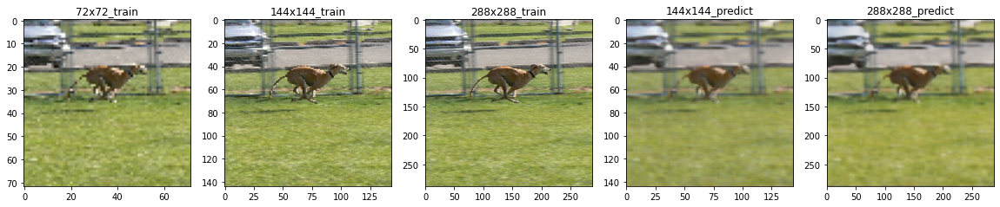

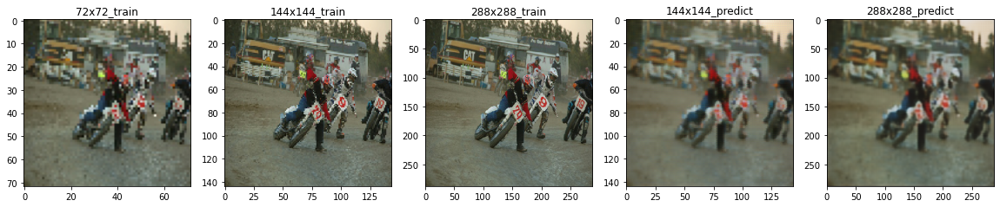

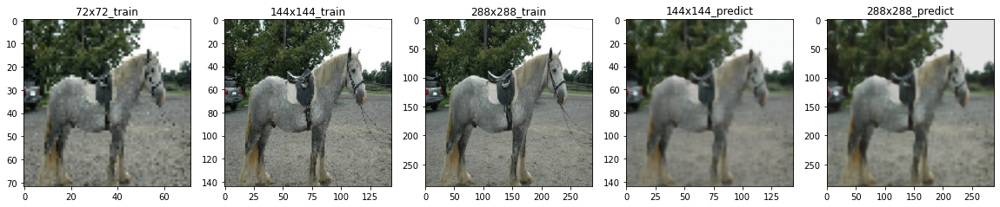

In [55]:
titles_5 = ["72x72_train","144x144_train","288x288_train","144x144_predict","288x288_predict"]
imgs_72_144_288_gen_val = get_gen_three(0,1000,72,144,288)
preds_seventh_sr = seventh_sr_model.predict_generator(imgs_72_144_288_gen_val,1000)
plot_predict_imgs(1,5,preds_seventh_sr,10,0,titles_5)

In [56]:
del preds_seventh_sr
gc.collect()

113189

## Conclusions
---
### We saw that different types of architecture yields different results in our quest to perform the task of Super-Resolutions.<br> We defined the metric of PSNR to test how much we lose in the 'compression' process, i.e. the task.<br>We saw that the although the PSNR stays very much the same, there are still significant results between model.<br> So far our seventh model was the best, we can take the task even further by trying to combine our different models in order to yield better results.